In [ ]:
pip install librosa

Note: you may need to restart the kernel to use updated packages.


In [ ]:
import os
import librosa
import librosa.display
import IPython.display as ipd
import numpy as np
import matplotlib.pyplot as plt

## Loading audio files with Librosa

In [ ]:
BASE_DIR='/Users/noeliamartinezmolina/Documents/LSD_MEG/Music/'
ambient_file = "Eleusian-Lullaby_mono1.mp3"

In [ ]:
ipd.Audio(os.path.join(BASE_DIR,ambient_file))

In [ ]:
# load audio files with librosa
ambient, sr = librosa.load(os.path.join(BASE_DIR,ambient_file))

## Extracting Short-Time Fourier Transform

In [ ]:
FRAME_SIZE = 2048
HOP_SIZE = 512

In [ ]:
S_ambient = librosa.stft(ambient, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)

In [ ]:
S_ambient.shape

(1025, 58060)

In [ ]:
type(S_ambient[0][0])

numpy.complex64

## Calculating the spectrogram

In [ ]:
Y_ambient = np.abs(S_ambient) ** 2

In [ ]:
Y_ambient.shape

(1025, 58060)

In [ ]:
type(Y_ambient[0][0])

numpy.float32

## Visualizing the spectrogram

In [ ]:
def plot_spectrogram(Y, sr, hop_length, y_axis="linear"):
    plt.figure(figsize=(25, 10))
    librosa.display.specshow(Y,
                             sr=sr,
                             hop_length=hop_length,
                             x_axis="time",
                             y_axis=y_axis)
    plt.colorbar(format="%+2.f")

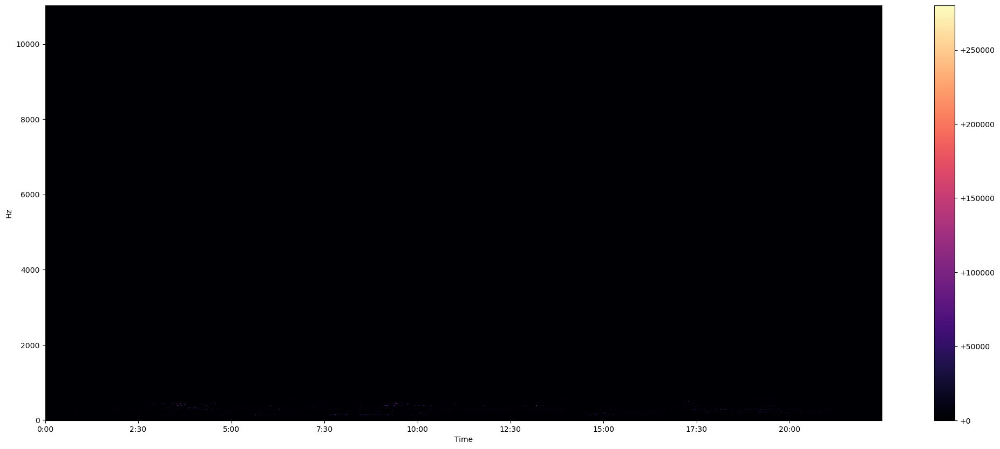

In [ ]:
plot_spectrogram(Y_ambient, sr, HOP_SIZE)

## Log-Amplitude Spectrogram

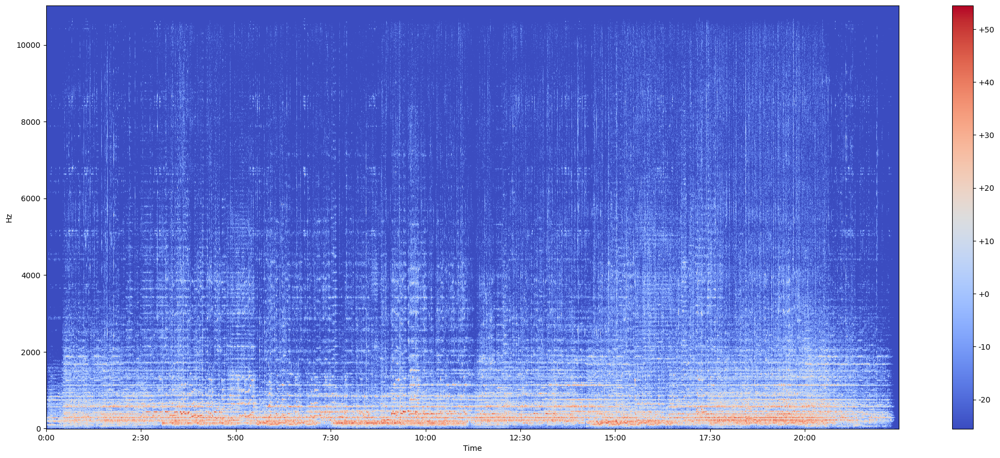

In [ ]:
Y_log_ambient = librosa.power_to_db(Y_ambient)
plot_spectrogram(Y_log_ambient, sr, HOP_SIZE)

## Log-Frequency Spectrogram

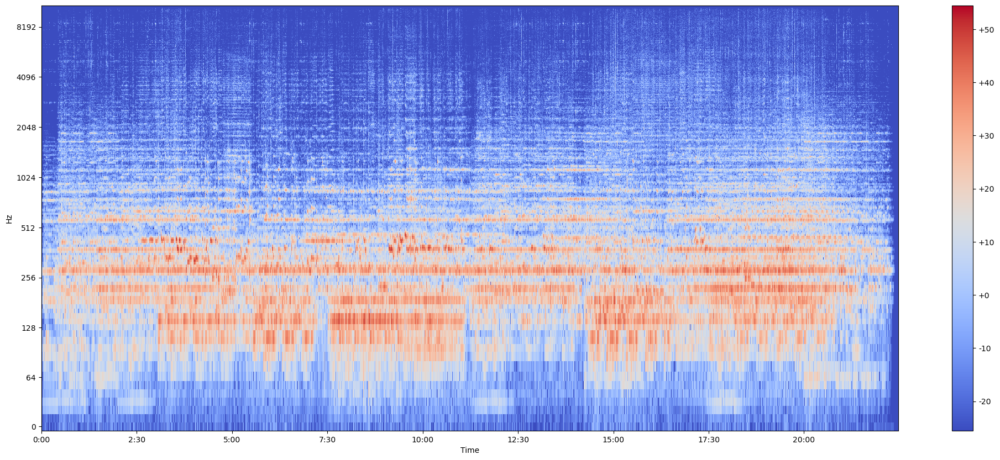

In [ ]:
plot_spectrogram(Y_log_ambient, sr, HOP_SIZE, y_axis="log")